In [1]:
import sys
import pickle
from os.path import join
sys.path.append("../../src")

import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import to_rgba
from matplotlib.collections import PolyCollection

from scipy.stats import spearmanr

import video_analyses
from data_processing import *
from plot_utils import *
import mne

import warnings
warnings.filterwarnings("ignore")


# FOR GUIDELINES
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = ['Arial']
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300

%load_ext autoreload
%autoreload 2

In [2]:
import pkg_resources

# List of external modules used (excluding standard library modules)
modules = ["pandas", "numpy", "seaborn", "matplotlib", "scipy", "statsmodels", "mne"]

# Create and write to requirements.txt
with open("requirements.txt", "w") as f:
    for module in modules:
        try:
            # Get the version and write it to the file
            version = pkg_resources.get_distribution(module).version
            f.write(f"{module}=={version}\n")
        except pkg_resources.DistributionNotFound:
            print(f"{module} is not installed in the environment.")


In [3]:
# Importing seaborn and matplotlib to check versions
import seaborn as sns
import matplotlib

print(sns.__version__)
print(matplotlib.__version__)
# 0.12.0
# 3.6.0

0.12.0
3.6.0


In [4]:
participants = ['00','01','02','04','05','06','07','08','09','10','11','12','13','14','15', '16', 
                '17', '20', '23', '24', '26', '28', '30','31','32','33','34']

unresponsive_IDs = ['02', '06', '10', '11', '15', '16', '20', '26', '30', '32', '34']
relaxed_IDs = ['00', '01', '04', '05', '07', '08', '09', '12', '13', '14', '17', '23', '24', '28', '31', '33']

In [5]:
regions = {
    'frontal': ['Fp2', 'AF4', 'AF8', 'F8', 'F6', 'F4', 'F2', 'Fp1', 'AF3', 'AF7', 'F7', 'F5', 'F3', 'F1'],
    'temporal': ['FT8', 'FT10', 'T8', 'TP8', 'TP10', 'FT7', 'FT9', 'T7', 'TP7', 'TP9'],
    'central': ['FC2', 'FC4', 'FC6', 'C6', 'C4', 'C2', 'FC1', 'FC3', 'FC5', 'C5', 'C3', 'C1'],
    'parietal': ['CP2', 'CP4', 'CP6', 'P6', 'P4', 'P2', 'CP1', 'CP3', 'CP5', 'P5', 'P3', 'P1'],
    'occipital': ['P8', 'PO8', 'PO4', 'O2', 'P7', 'PO7', 'PO3', 'O1'],
    'midline': ['AFz', 'Fz', 'Cz', 'CPz', 'Pz', 'POz', 'Oz', 'Iz']
}

_________________________

### IMPORT EEG DATA (DIRECTLY FROM PICKLE)

In [6]:
files = [
    ('alpha_averages_dict_ALL.pickle', 'alpha_averages'),
    ('beta_averages_dict_ALL.pickle', 'beta_averages'),
    ('alpha_averages_ctl_dict_ALL.pickle', 'alpha_averages_ctl'),
    ('beta_averages_ctl_dict_ALL.pickle', 'beta_averages_ctl')
]

for filename, variable_name in files:
    file_path = join('..', 'data', filename) 
    with open(file_path, 'rb') as handle:
        data_dict = pickle.load(handle)
        globals()[variable_name] = pd.concat(data_dict.values())

beta_averages_ctl.head()

,frontal_beta,temporal_beta,central_beta,parietal_beta,occipital_beta,midline_beta,Time,ID
1,0.278098,0.299352,0.309159,0.297690,0.283117,0.289844,1,00
2,0.285144,0.275057,0.293947,0.280718,0.275493,0.277542,2,00
3,0.267578,0.278197,0.290168,0.278361,0.272991,0.263316,3,00
4,0.286424,0.286572,0.295433,0.287110,0.277675,0.277370,4,00
5,0.284382,0.287652,0.294483,0.291062,0.287835,0.285692,5,00


In [7]:
len(beta_averages_ctl.ID.unique())

27

# IMPORT EEG DATA 

### IMPORT ECG DATA

In [8]:
LF_normalized_zg = pd.read_csv(join('..', 'data', 'LF_normalized_zg.csv'))
LF_normalized_ctl = pd.read_csv(join('..', 'data', 'LF_normalized_ctl.csv'))
HF_normalized_zg = pd.read_csv(join('..', 'data', 'HF_normalized_zg.csv'))
HF_normalized_ctl = pd.read_csv(join('..', 'data', 'HF_normalized_ctl.csv'))
Fratio_normalized_zg = pd.read_csv(join('..', 'data', 'Fratio_normalized_zg.csv'))
Fratio_normalized_ctl = pd.read_csv(join('..', 'data', 'Fratio_normalized_ctl.csv'))

LF_normalized_zg.head()

,Unnamed: 0,LF_avg_00,LF_avg_01,LF_avg_02,LF_avg_04,LF_avg_05,LF_avg_06,LF_avg_07,LF_avg_08,LF_avg_09,...,LF_avg_30,LF_avg_31,LF_avg_32,LF_avg_33,LF_avg_34,Avg,Std,time,Std_smooth,Avg_smooth
0,0,0.120580,0.314118,0.282461,0.112915,0.223188,0.167877,0.247872,0.244886,0.465616,...,0.113256,0.019856,0.201690,0.035317,0.142828,0.220174,0.135385,60,0.135385,0.220174
1,1,0.274607,0.340863,0.444117,0.237199,0.436539,0.209137,0.199086,0.432089,0.938753,...,0.089333,0.264370,0.566033,0.054771,0.105284,0.305209,0.198026,65,0.166705,0.262692
2,2,0.380997,0.438966,0.237398,0.434605,0.305502,0.215840,0.244428,0.381090,0.965082,...,0.099743,0.310257,0.605865,0.066671,0.156149,0.328211,0.199842,70,0.177751,0.284532
3,3,0.644636,0.429997,0.252595,0.485999,0.312102,0.205922,0.531929,0.352811,0.807983,...,0.110339,0.372794,0.584428,0.056654,0.212541,0.357051,0.193929,75,0.181795,0.302661
4,4,0.504642,0.423171,0.355214,0.527290,0.745225,0.218669,0.588877,0.416779,0.887344,...,0.138587,0.386724,0.629668,0.060399,0.304992,0.401636,0.222675,80,0.189971,0.322456


### IMPORT STAI-Y1 SCORES

In [9]:
STAIY = pd.read_csv(join('..', 'Data', 'STAI-Y1-SCORES.csv'), sep=';') #sep= ',' plutôt ? ça bugait avant
STAIY['order'] = STAIY['order'].astype(str)
#STAIY['group'] = STAIY['group'].replace({0:1, 1:0}) #quand j'avais inversé les 0 et les 1 dans csv, c'était pour inverser automatiquement, mais maintenant c'est corrigé normalement
STAIY.head()

,Participant,score,order,group,baseline
0,0,35,0,0,35
1,1,31,0,0,22
2,2,34,0,1,35
3,4,28,0,0,22
4,5,37,0,0,39


### IMPORT ALL METRIC TO PLOT VIOLINS

In [10]:
# import melted_data for all metrics : EEG midline beta, EEG midline alpha, LF, HF, Fratio
melted_data_metrics = pd.read_csv(join('..', 'data', 'df_metrics_melted.csv'))
melted_data_metrics.head()

,ID,condition,group,variable,value
0,0,1,0,LF_avg,0.093377
1,0,1,0,HF_avg,0.067410
2,0,1,0,Fratio_avg,0.196809
3,0,1,0,midline_alpha,0.246577
4,0,1,0,midline_beta,0.289777


## Figure 1. Condition effects on STAI-Y1 ratings, neural and cardiac correlates.

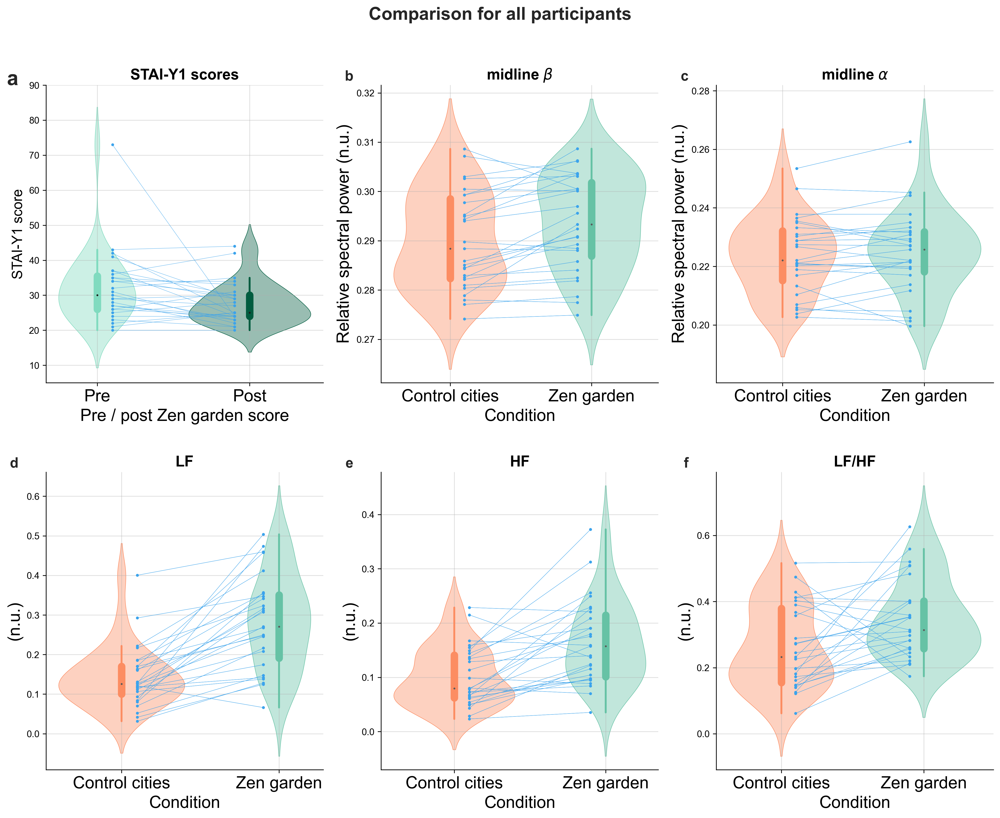

In [11]:
violin_plots_metrics_and_staiy(melted_data_metrics, STAIY, None, 'all', 0)
#violin_plots_metrics_and_staiy(melted_data_metrics, STAIY, 0, 'responsive', 0)
#violin_plots_metrics_and_staiy(melted_data_metrics, STAIY, 1, 'unresponsive', 0)

## Figure 2. ECG HF spectral component differences across conditions in all participants and each subgroup.

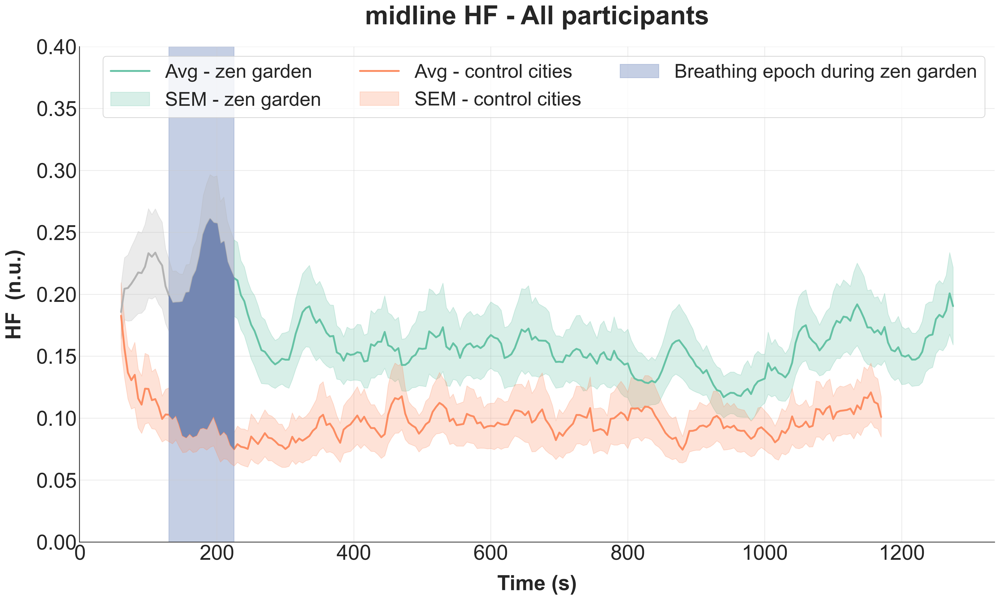

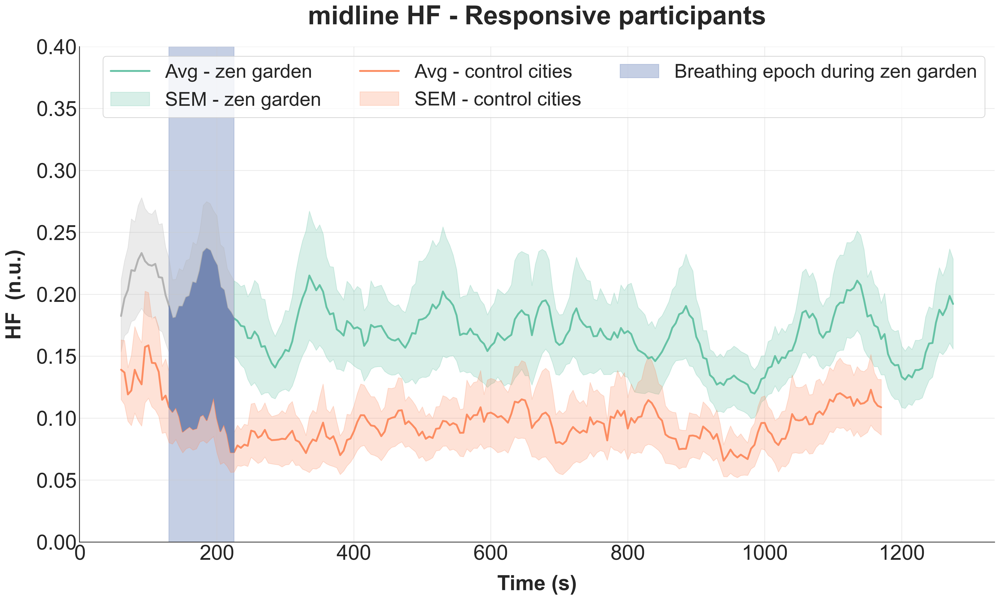

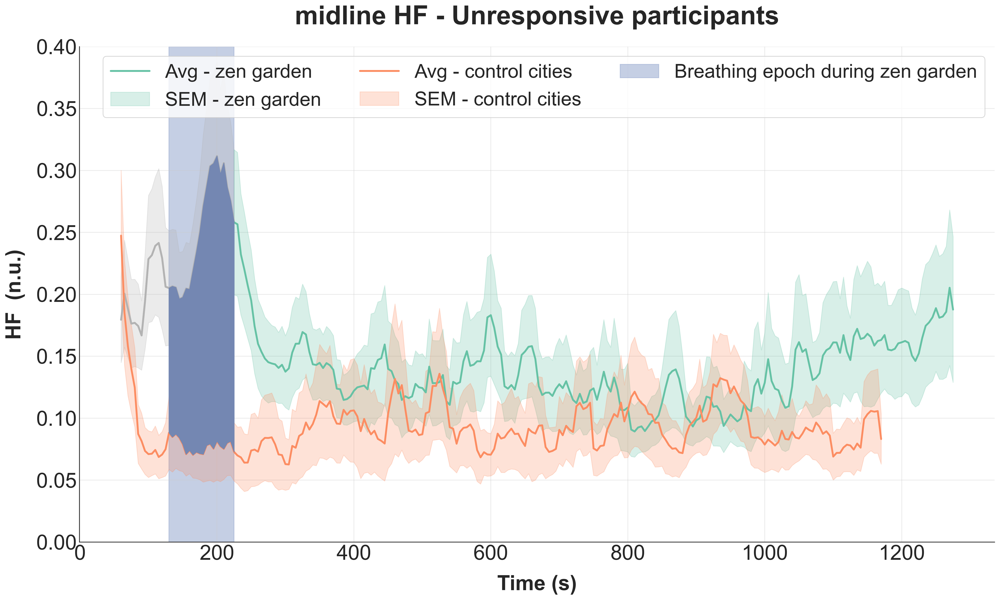

In [12]:
smoothness = 5
subgroups = [unresponsive_IDs, relaxed_IDs]
HF_unresponsive_zg, HF_unresponsive_ctl, HF_relaxed_zg, HF_relaxed_ctl = divide_ECG_into_groups(globals()[f"{'HF'}_normalized_zg"], globals()[f"{'HF'}_normalized_ctl"], subgroups, 'HF')

temporal_plot_comparison(HF_normalized_zg, HF_normalized_ctl, region='HF', band='', type='ECG', participants='All',highlight_epoch_start= 14, highlight_epoch_end=33, smoothness=5, leg_pos='upper right', n=27)
temporal_plot_comparison(HF_relaxed_zg, HF_relaxed_ctl, region='HF', band='', type='ECG', participants='Responsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=16)
temporal_plot_comparison(HF_unresponsive_zg, HF_unresponsive_ctl, region='HF', band='', type='ECG', participants='Unresponsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=11)

## Figure 3. ECG LF/HF ratio differences across conditions in all participants and each subgroup.

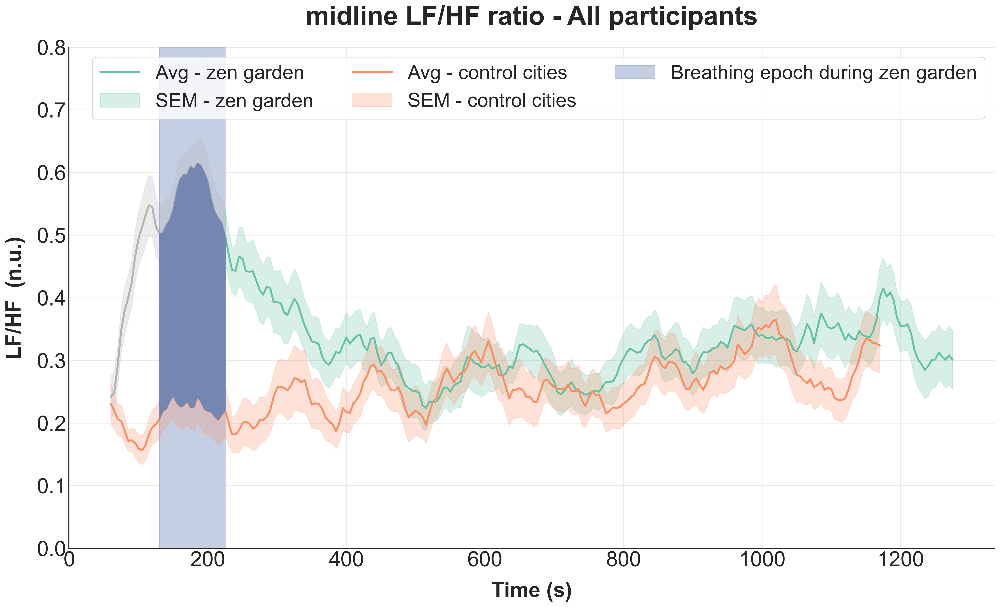

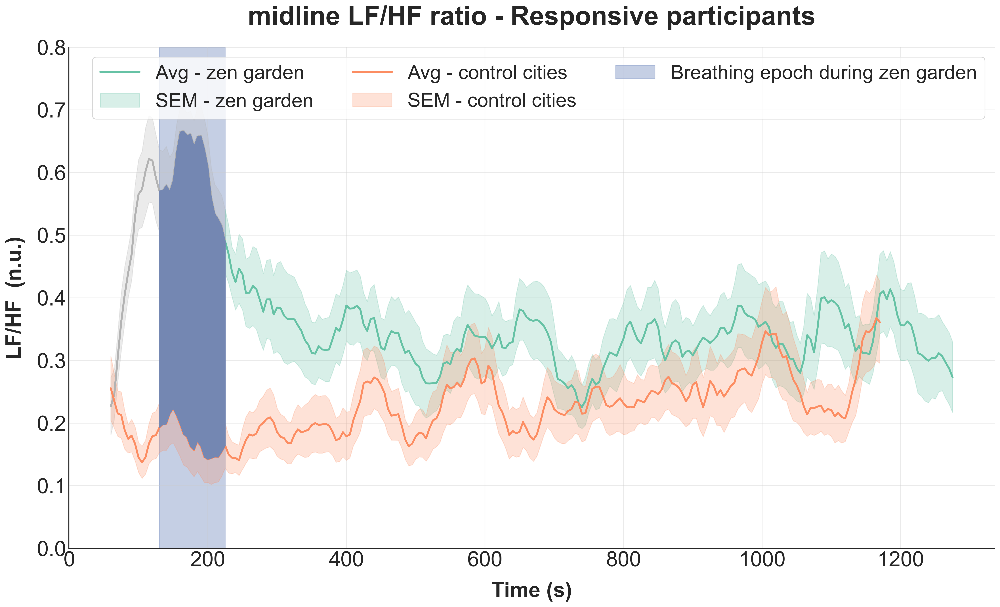

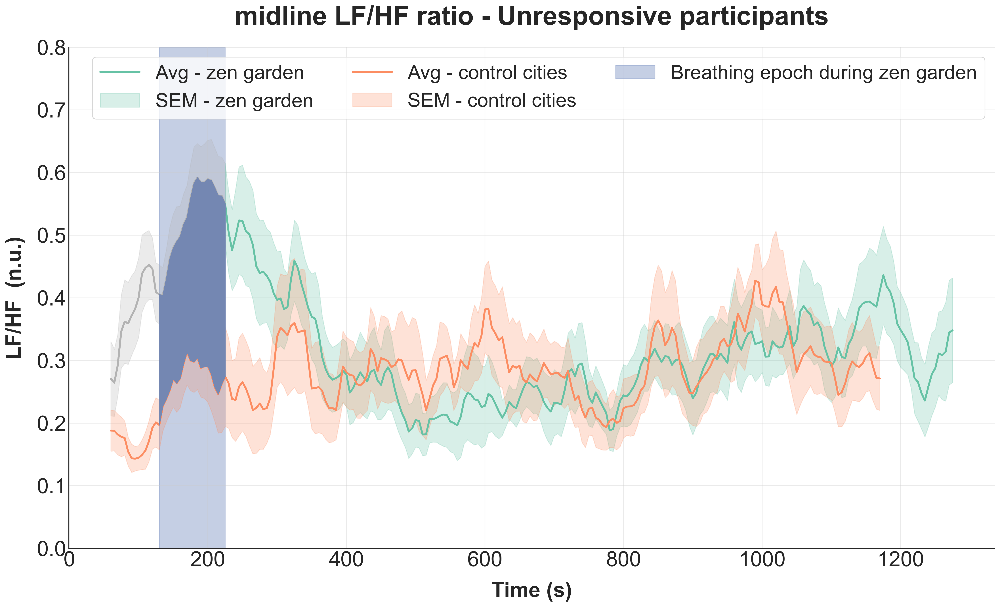

In [13]:
smoothness = 2
subgroups = [unresponsive_IDs, relaxed_IDs]
Fratio_unresponsive_zg, Fratio_unresponsive_ctl, Fratio_relaxed_zg, Fratio_relaxed_ctl = divide_ECG_into_groups(globals()[f"{'Fratio'}_normalized_zg"], globals()[f"{'Fratio'}_normalized_ctl"], subgroups, 'Fratio')

temporal_plot_comparison(Fratio_normalized_zg, Fratio_normalized_ctl, region='LF/HF', band='', type='ECG', participants='All', highlight_epoch_start= 14, highlight_epoch_end=33, smoothness=2, leg_pos='upper right', n=27)
temporal_plot_comparison(Fratio_relaxed_zg, Fratio_relaxed_ctl, region='LF/HF', band='', type='ECG', participants='Responsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=16)
temporal_plot_comparison(Fratio_unresponsive_zg, Fratio_unresponsive_ctl, region='LF/HF', band='', type='ECG', participants='Unresponsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=11)

## Figure 4. EEG beta band relative spectral power response in each subgroup.

To display the same temporal analysis but for the alpha band instead of beta, please decomment the line below in the "for loop"

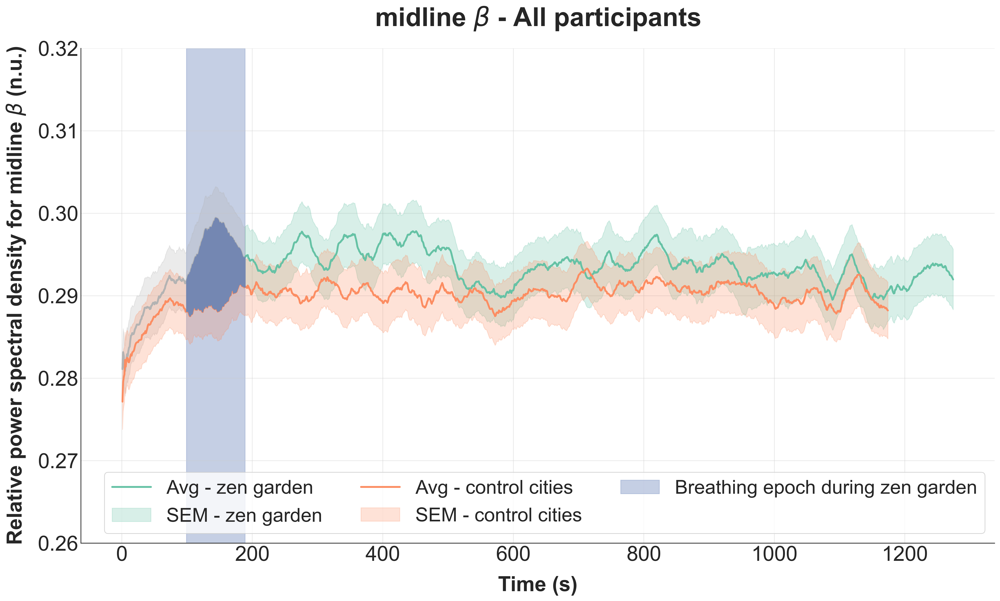

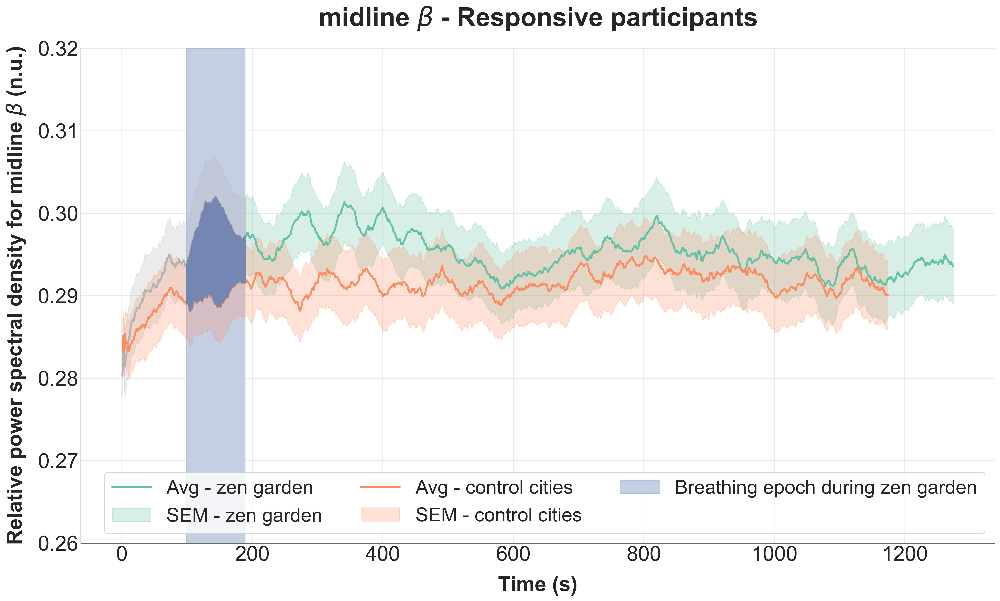

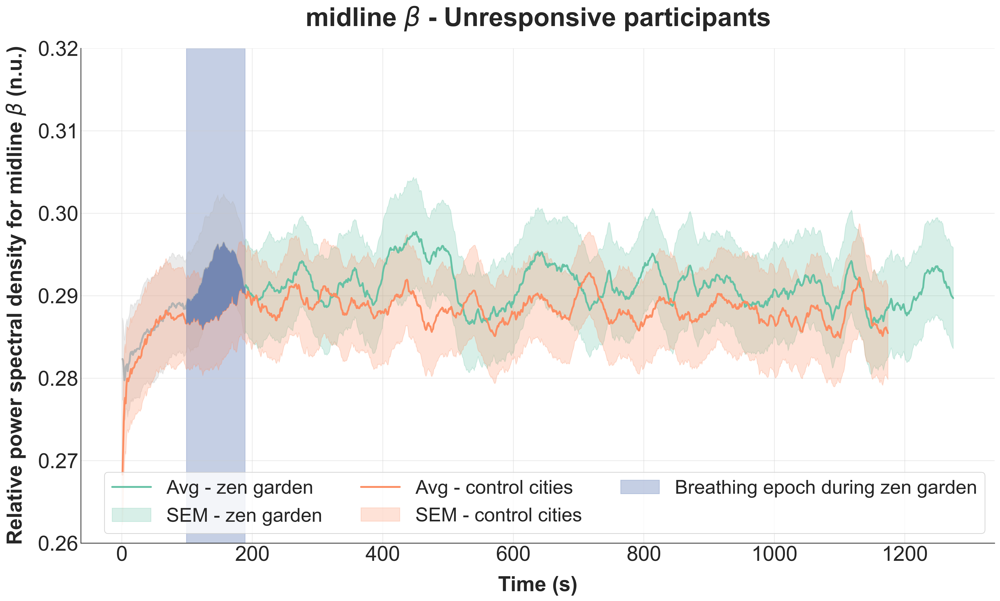

In [14]:
participant_groups = [
    {'group': participants, 'label': 'All', 'n': 27},
    {'group': relaxed_IDs, 'label': 'Responsive','n':16},
    {'group': unresponsive_IDs, 'label': 'Unresponsive', 'n': 11}
]

for group_info in participant_groups:
    
    group, label, number = group_info['group'], group_info['label'], group_info['n']

    # Computes the average across participants of same group (all, resp, unresp)
    regions_alpha, regions_beta, regions_alpha_ctl, regions_beta_ctl = process_EEG_by_group(alpha_averages, beta_averages, alpha_averages_ctl, beta_averages_ctl, group)

    # BETA BAND
    temporal_plot_comparison(regions_beta.copy(), regions_beta_ctl.copy(), region='midline', band='beta', type='EEG', participants=label, highlight_epoch_start=98, highlight_epoch_end=188, smoothness=30, leg_pos='lower right', n=number)

    # ALPHA BAND
    # temporal_plot_comparison(regions_alpha.copy(), regions_2D_alpha.copy(), region='midline', band='alpha', type='EEG', participants=label, highlight_epoch_start=98, highlight_epoch_end=188, smoothness=30, leg_pos='lower right', n=number)


## Violin plots of responsive and unresponsive groups visible in Figures 2. 3. & 4. c. & e. 

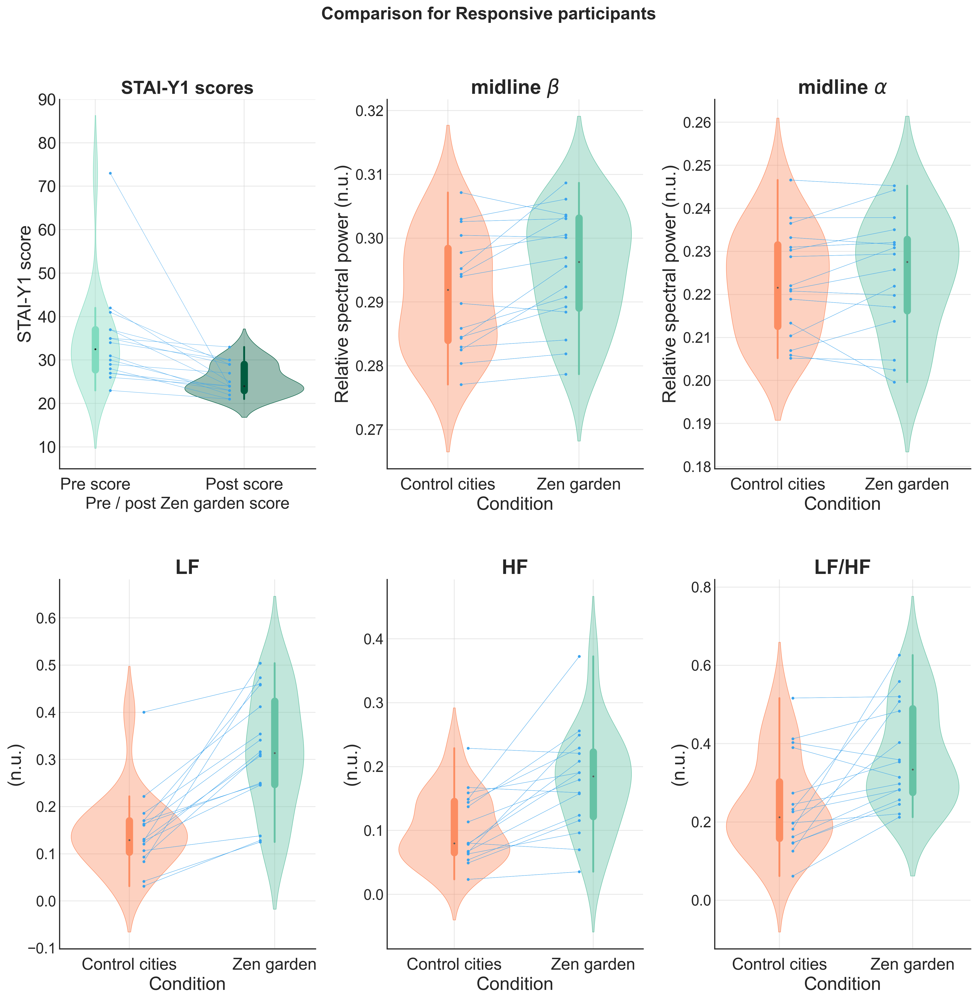

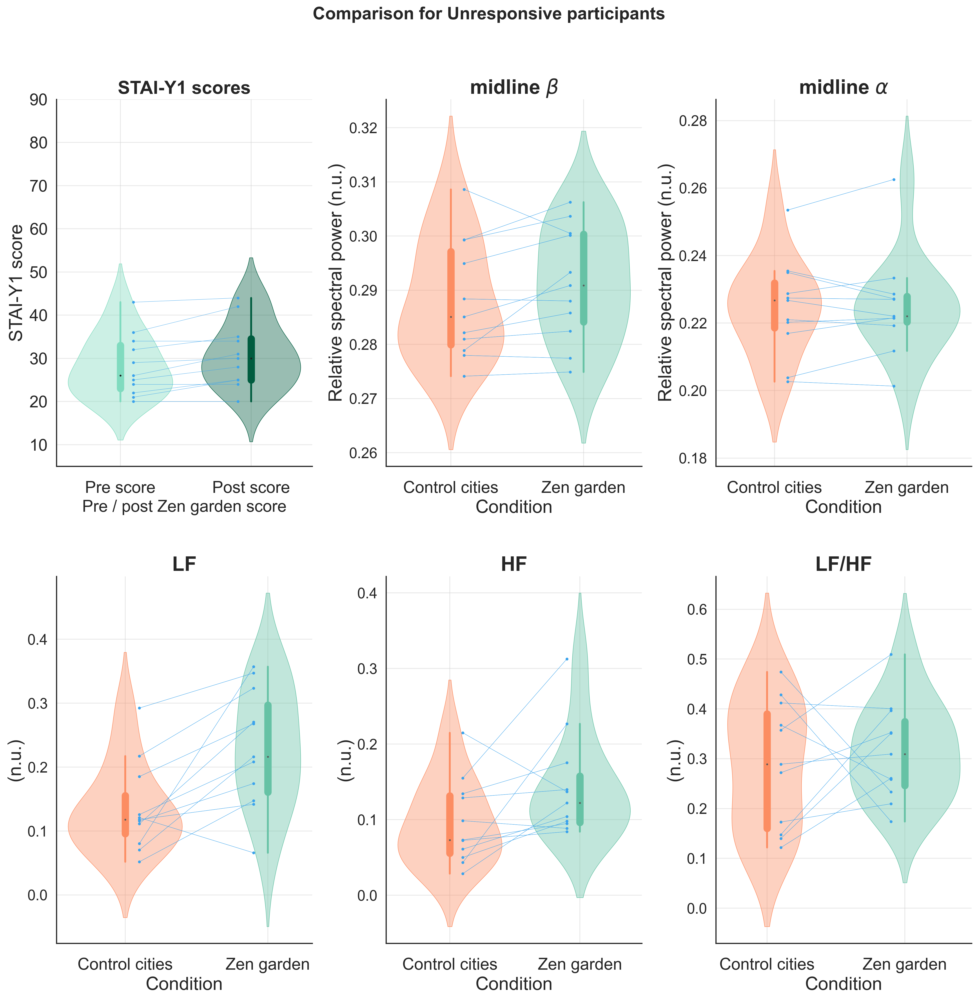

In [15]:
violin_plots_metrics_and_staiy_subgroups(melted_data_metrics, STAIY, 0, 'Responsive', 0)
violin_plots_metrics_and_staiy_subgroups(melted_data_metrics, STAIY, 1, 'Unresponsive', 0)

# Topographic map of beta responsive & unresponsive groups: Figure 4 d & g

In [16]:
beta_regions = pd.read_csv(join('..', 'data', 'EEG_beta_regions.csv'))
beta_values = process_EEG_for_topoplot(beta_regions, 'beta')
beta_values.head()

,condition,group,variable,value
0,0,0,central_beta,0.307635
1,0,0,frontal_beta,0.291805
2,0,0,midline_beta,0.295219
3,0,0,occipital_beta,0.287295
4,0,0,parietal_beta,0.293836


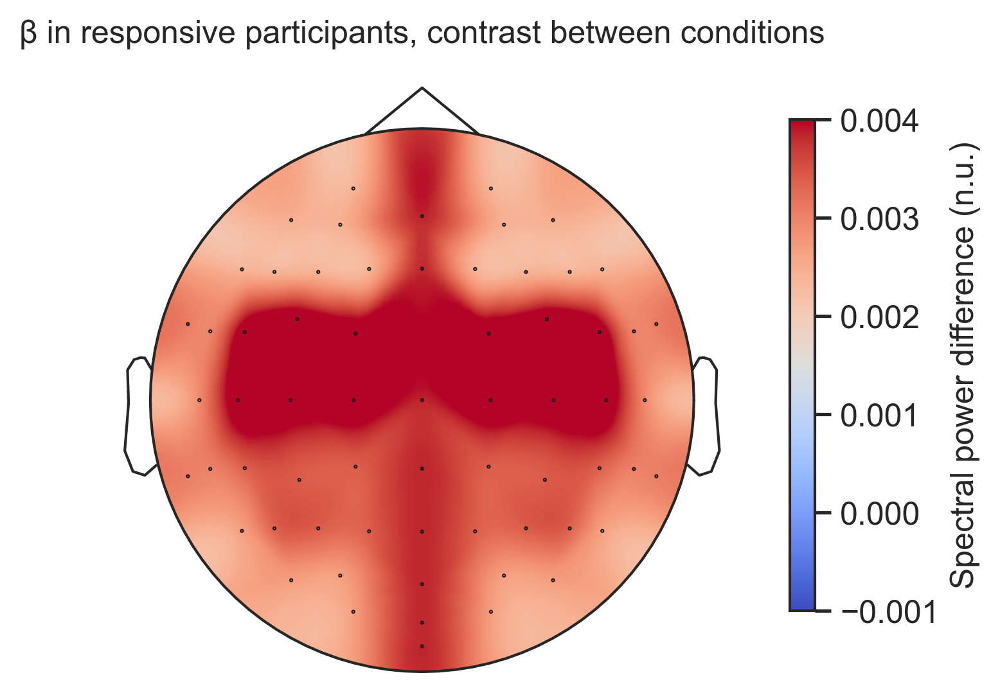

In [17]:
contrast_beta_responsives = extract_contrast_values(beta_values, 0, 'beta')
plot_contrast_topomap(regions, contrast_beta_responsives, vlim = (-0.001,0.004), title='β in responsive participants, contrast between conditions')

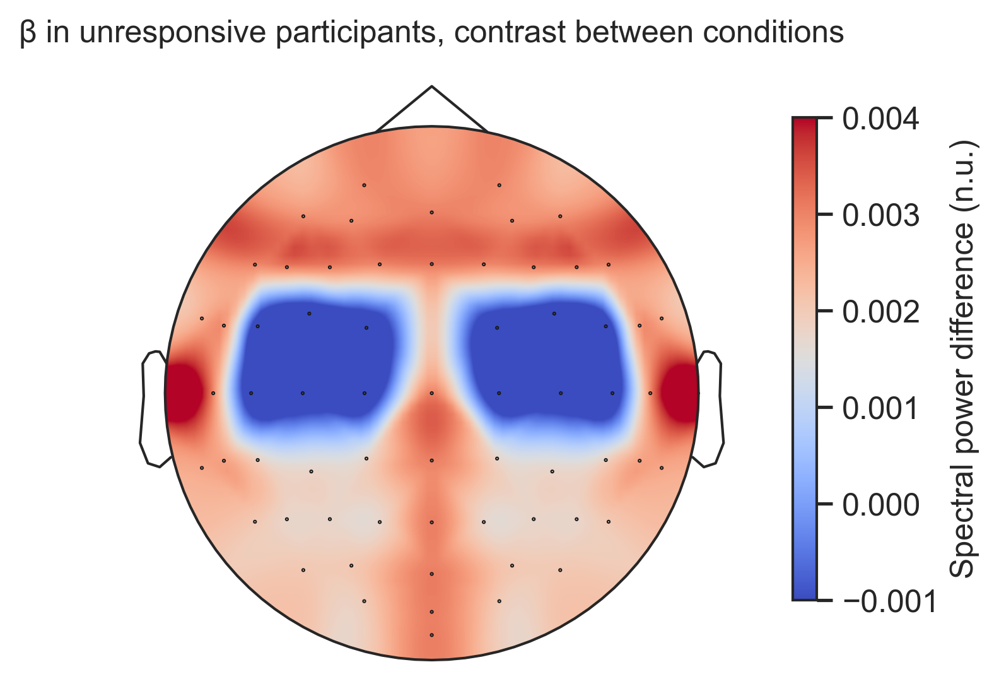

In [18]:
contrast_beta_unresponsives = extract_contrast_values(beta_values, 1, 'beta')
plot_contrast_topomap(regions, contrast_beta_unresponsives, vlim = (-0.001,0.004), title='β in unresponsive participants, contrast between conditions')

## Figure 5. Brain-to-heart coupling coefficients across conditions in responsive and unresponsive groups.


### remove outlier participant

In [19]:
brain_heart_coeffs = pd.read_csv(join('..', 'data', 'brain_heart_coefficients.csv'))
brain_heart_coeffs = remove_outliers(brain_heart_coeffs)
brain_heart_coeffs.head()

Aberrant data detected (outliers):
    Unnamed: 0  ID  group variable      value  condition  is_outlier
68          68  15      1     HF2B  57.151672          1        True


,Unnamed: 0,ID,group,variable,value,condition
0,0,0,0,B2HF,0.020959,1
1,1,1,0,B2HF,0.000923,1
2,2,2,1,B2HF,0.011812,1
3,3,4,0,B2HF,0.004471,1
4,4,5,0,B2HF,0.006211,1


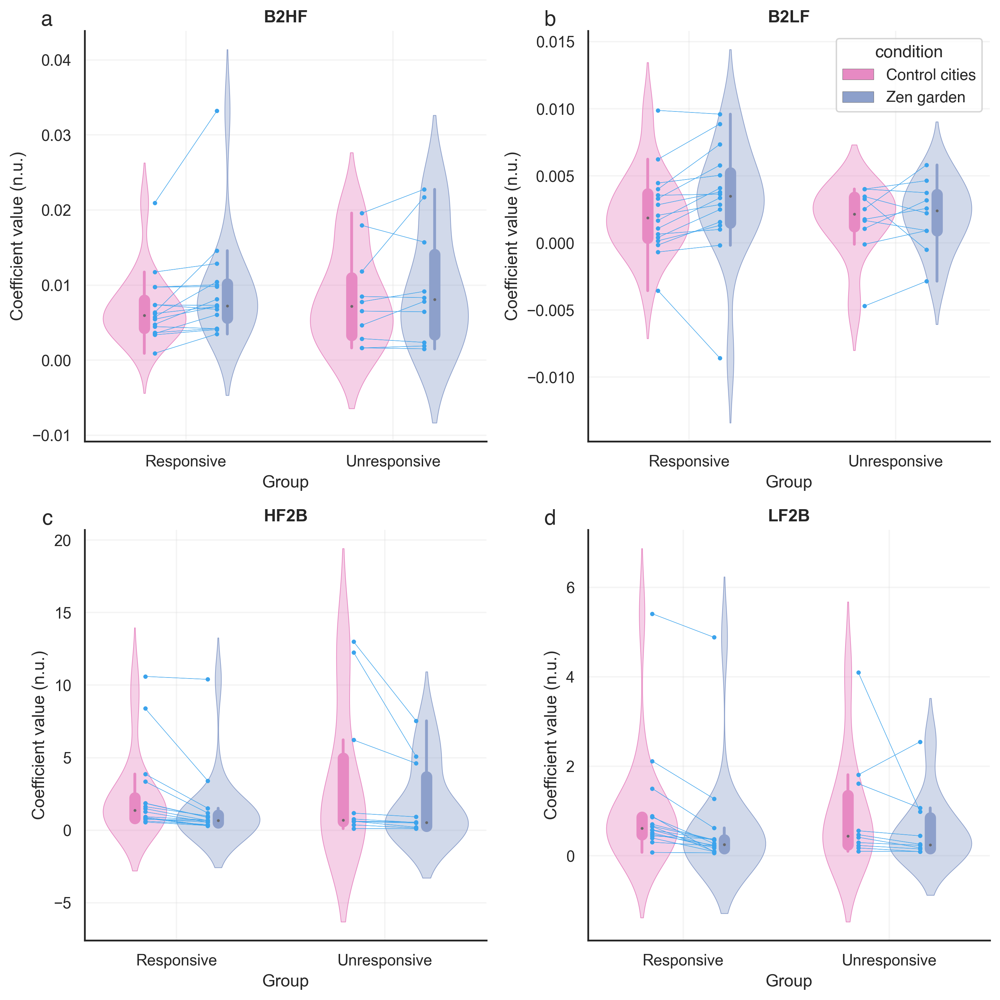

In [20]:
generate_brain_heart_coupling_plots(brain_heart_coeffs)

## Figure 6. Response magnitude (delta STAI-Y1) in relation to LF/HF ratio

In [21]:
# please refer to R code